In [1]:
from Loader_17 import DAVIS_Rawset, normalize
from deform_video import DAVIS_withPoint, IMGPositionEmbeddingSine, PositionalEncoding, get_valid_ratio, MLP
from deform_model import DeformableTransformerDecoderLayer, DeformableTransformerDecoder, get_batch_average_bou_iou
from torch.utils.data import DataLoader, Dataset
import matplotlib.pyplot as plt
import torch
from torch import nn
from torch.optim import Adam
from einops import rearrange, repeat, reduce
import numpy as np
import torch.nn.functional as F
import gc
from polygon import SoftPolygon, RasLoss
import random
from tqdm import tqdm

In [2]:
val_raw_set = DAVIS_Rawset(is_train=False)

In [3]:
train_raw_set = DAVIS_Rawset(is_train=True)

In [3]:
!env | grep CUDA_VISIBLE_DEVICES

CUDA_VISIBLE_DEVICES=2
CUDA_VISIBLE_DEVICES1=2,0,3,1


In [ ]:
# torch.cuda.set_device(1)

In [3]:
gt_rasterizer = SoftPolygon(1, "hard_mask").cuda()
ras_loss = RasLoss().cuda()

In [4]:
val_point_set = DAVIS_withPoint(val_raw_set, 32, is_train=False)


In [ ]:
train_point_set = DAVIS_withPoint(train_raw_set, 32, is_train=True)

In [172]:
val_point_set[0][2][2].shape

torch.Size([32, 2])

tensor(0.9844, device='cuda:0')


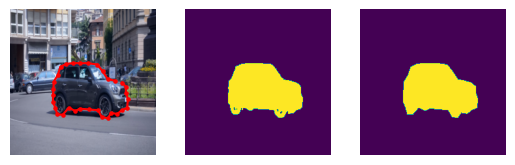

In [173]:
video_idx = 7
frame_idx = 0
img, mask, point = val_point_set.raw_data_set[video_idx][frame_idx]
poly_mask = gt_rasterizer(point.unsqueeze(0).cuda(), 224, 224)
plt.subplot(1, 3, 1)
plt.axis("off")
plt.imshow(normalize(img).permute(1, 2, 0))
plt.plot(point[:, 0], point[:, 1], c="r")
plt.scatter(point[:, 0], point[:, 1], c="r", s=5)
plt.subplot(1, 3, 2)
plt.axis("off")
plt.imshow(mask)
plt.subplot(1, 3, 3)
plt.axis("off")
plt.imshow(poly_mask[0].cpu().detach().numpy())
print(
    get_batch_average_bou_iou(
        point.unsqueeze(0).cuda(),
        mask.unsqueeze(0).cuda(),
        gt_rasterizer,
    )
)

In [5]:
class DAVIS_Video(Dataset):
    def __init__(
        self,
        raw_set: list[list[tuple[torch.Tensor, torch.Tensor, torch.Tensor]]],
        frame_num: int,
        video_idx_list: list[int] = None,
        is_eval: bool = False,
        use_fir_point: bool = True,
    ):
        self.raw_set = raw_set
        if video_idx_list is not None:
            self.raw_set = [self.raw_set[i] for i in video_idx_list]
        self.frame_num = frame_num
        self.is_eval = is_eval
        self.use_fir_point = use_fir_point

    def __len__(self):
        return len(self.raw_set)

    def __getitem__(self, idx):
        video_data = self.raw_set[idx]
        total_frame_num = len(video_data)
        selected_frame_idxs = []
        if total_frame_num < self.frame_num:
            selected_frame_idxs = list(range(total_frame_num))
        else:
            # uniformly sample frame_num frames, and the first frame is always included
            selected_frame_idxs = [0]
            interval = (total_frame_num - 1) // (self.frame_num - 1)
            if self.is_eval:
                offset = 0
            else:
                offset_min = -(interval - 1)
                offset_max = (total_frame_num - 1) - (self.frame_num - 1) * interval
                offset = random.randint(offset_min, offset_max)
            for i in range(1, self.frame_num):
                selected_frame_idxs.append(i * interval + offset)
        selected_frame_idxs = sorted(selected_frame_idxs)
        img_list = []
        mask_list = []
        point_list = []
        fir_point = video_data[0][2]
        for frame_idx in selected_frame_idxs:
            img, mask, point = video_data[frame_idx]
            img_list.append(img)
            mask_list.append(mask)
            if self.use_fir_point:
                point_list.append(fir_point)
            else:
                point_list.append(point)
        return torch.stack(img_list), torch.stack(mask_list), torch.stack(point_list)


val_video_set = DAVIS_Video(val_point_set.raw_data_set, 10, [22], is_eval=True, use_fir_point=False)
val_video_set[0]
None

In [189]:
val_video_loader = DataLoader(val_video_set, batch_size=1, shuffle=False)

torch.Size([1, 10, 3, 224, 224]) torch.Size([1, 10, 224, 224]) torch.Size([1, 10, 32, 2])
tensor(0.9398, device='cuda:0')


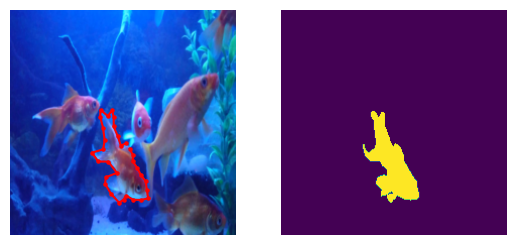

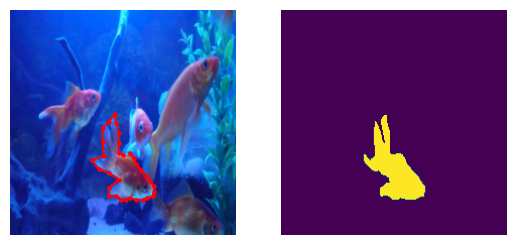

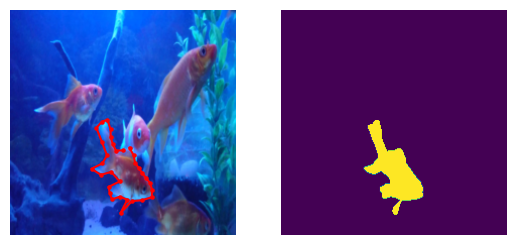

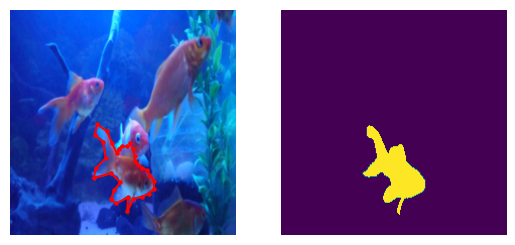

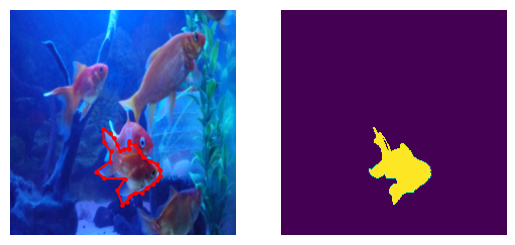

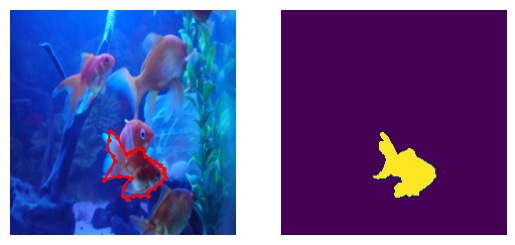

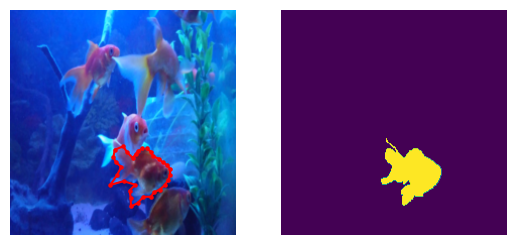

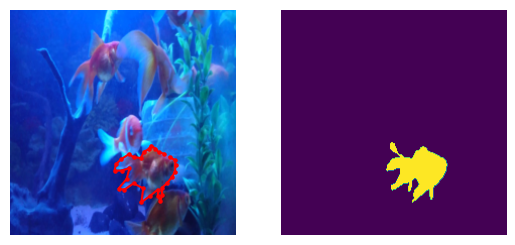

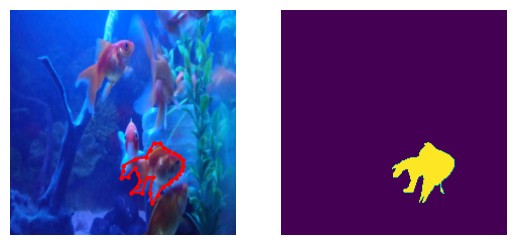

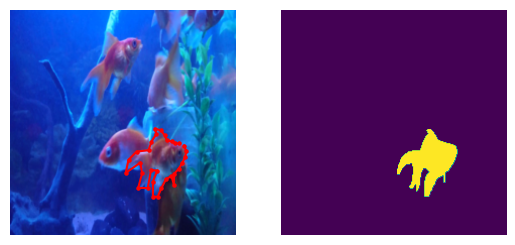

In [ ]:
total_imgs, total_masks, total_points = next(iter(val_video_loader))
print(total_imgs.shape, total_masks.shape, total_points.shape)
print(
    get_batch_average_bou_iou(
        rearrange(total_points.cuda(), "b f p xy -> (b f) p xy"),
        rearrange(total_masks.cuda(), "b f h w -> (b f) h w"),
        gt_rasterizer,
    )
)
for i in range(len(total_imgs[0])):
    plt.subplot(1, 2, 1)
    plt.axis("off")
    plt.imshow(normalize(total_imgs[0][i]).permute(1, 2, 0))
    plt.plot(total_points[0][i][:, 0], total_points[0][i][:, 1], c="r")
    plt.scatter(total_points[0][i][:, 0], total_points[0][i][:, 1], c="r", s=5)
    plt.subplot(1, 2, 2)
    plt.axis("off")
    plt.imshow(total_masks[0][i])
    plt.show()

In [ ]:
total_imgs, total_masks, total_points = next(iter(val_video_loader))
total_imgs.shape, total_masks.shape, total_points.shape

(torch.Size([1, 10, 3, 224, 224]),
 torch.Size([1, 10, 224, 224]),
 torch.Size([1, 10, 32, 2]))

In [8]:
class Cotracker(nn.Module):
    def __init__(
        self,
        point_num: int,
        refine_iter: int = 6,
        freeze_featup: bool = True,
        d_model: int = 384,
        n_heads: int = 6,
        n_points: int = 8,
        d_ffn: int = 2048,
    ):
        super(Cotracker, self).__init__()
        self.refine_iter = refine_iter
        self.featup = torch.hub.load(
            "mhamilton723/FeatUp",
            "dino16",
            use_norm=True,
        )
        if freeze_featup:
            for param in self.featup.parameters():
                param.requires_grad = False
        d_featup = 384
        if d_featup != d_model:
            self.featup_fc = nn.Linear(d_featup, d_model)
        else:
            self.featup_fc = nn.Identity()

        self.medium_level_size = [14, 28, 56, 112]
        n_levels = len(self.medium_level_size) + 1
        n_layers = 1
        self.offset_ratio = 0.2
        self.pos_2d = IMGPositionEmbeddingSine(d_model)
        self.pos_1d = PositionalEncoding(d_model)
        self.level_pos = nn.Embedding(n_levels, d_model)
        nn.init.xavier_uniform_(self.level_pos.weight)

        self.query_embed = nn.Embedding(point_num, d_model)
        nn.init.xavier_uniform_(self.query_embed.weight)
        dec_layer = DeformableTransformerDecoderLayer(
            d_model=d_model,
            d_ffn=d_ffn,
            n_levels=n_levels,
            n_heads=n_heads,
            n_points=n_points,
        )
        self.def_dec_layernorm = nn.LayerNorm(d_model)
        self.def_decoder = DeformableTransformerDecoder(
            decoder_layer=dec_layer,
            num_layers=n_layers,
        )
        self.fir_layernorm = nn.LayerNorm(d_model)
        self.fir_encoder = nn.TransformerEncoder(
            encoder_layer=nn.TransformerEncoderLayer(
                d_model,
                n_heads,
                d_ffn,
                batch_first=True,
            ),
            num_layers=1,
        )
        self.other_layernorm = nn.LayerNorm(d_model)
        self.other_decoder = nn.TransformerDecoder(
            decoder_layer=nn.TransformerDecoderLayer(
                d_model,
                n_heads,
                d_ffn,
                batch_first=True,
            ),
            num_layers=1,
        )
        self.delta_xy_fc = MLP(d_model, d_model, 2, 3)
        self.delta_query_fc = MLP(d_model, d_model, d_model, 3)

    def forward(self, imgs: torch.Tensor, points: torch.Tensor):
        batch_size, frame_num, _, img_h, img_w = imgs.shape
        _, _, point_num, _ = points.shape

        points = points / 224.0

        fir_img = imgs[:, 0]
        fir_points = points[:, 0]
        (
            fir_src_flatten,
            fir_spatial_shapes,
            fir_level_start_index,
            fir_valid_ratios,
            fir_pos_embed_flatten,
        ) = self._get_img_scrs(fir_img, self.def_dec_layernorm)
        fir_src_flatten += fir_pos_embed_flatten
        fir_query_embed = repeat(self.query_embed.weight, "p d -> b p d", b=batch_size)
        fir_point_feats, _ = self.def_decoder(
            fir_query_embed,
            fir_points,
            fir_src_flatten,
            fir_spatial_shapes,
            fir_level_start_index,
            fir_valid_ratios,
        )
        fir_point_feats = self.fir_layernorm(fir_point_feats)
        fir_query = self.pos_1d(fir_point_feats)
        fir_memory = self.fir_encoder(fir_query)

        other_imgs = imgs[:, 1:]
        other_points = points[:, 1:]
        other_imgs = rearrange(other_imgs, "b f c h w -> (b f) c h w")
        other_points = rearrange(other_points, "b f p d -> (b f) p d")
        (
            other_src_flatten,
            other_spatial_shapes,
            other_level_start_index,
            other_valid_ratios,
            other_pos_embed_flatten,
        ) = self._get_img_scrs(other_imgs, self.def_dec_layernorm)
        other_src_flatten += other_pos_embed_flatten
        other_queries = repeat(
            self.query_embed.weight, "p d -> b p d", b=batch_size * (frame_num - 1)
        )

        output_coords = []
        for i in range(self.refine_iter):
            other_point_feats, _ = self.def_decoder(
                other_queries,
                other_points,
                other_src_flatten,
                other_spatial_shapes,
                other_level_start_index,
                other_valid_ratios,
            )
            other_point_queries = rearrange(
                other_point_feats, "(b f)p d -> b (f p) d", f=frame_num - 1
            )
            other_point_queries = self.other_layernorm(other_point_queries)
            other_point_queries = self.pos_1d(other_point_queries)
            other_point_queries = self.other_decoder(
                tgt=other_point_queries,
                memory=fir_memory,
            )
            other_point_queries = rearrange(
                other_point_queries, "b (f p) d -> (b f) p d", f=frame_num - 1
            )
            delta_xy = self.delta_xy_fc(other_point_queries)
            delta_xy = (delta_xy.sigmoid() - 0.5) * self.offset_ratio
            other_points = other_points + delta_xy
            result = rearrange(
                other_points, "(b f) p d -> b f p d", b=batch_size, f=frame_num - 1
            )
            result = result * 224.0
            output_coords.append(result)
            delta_query = self.delta_query_fc(other_point_feats)
            other_queries = other_queries + delta_query
        output_coords = torch.stack(output_coords, 1)
        return output_coords

    def _get_img_scrs(self, img: torch.Tensor, layernorm: nn.LayerNorm):
        b, c, h, w = img.shape
        feats = self.featup(img)
        feats = rearrange(feats, "b c h w -> b (h w) c")
        feats = self.featup_fc(feats)
        feats = rearrange(feats, "b (h w) c -> b c h w", h=h, w=w)
        srcs = []
        padding_masks = []
        pos_embeds = []
        for low_res in self.medium_level_size:
            srcs.append(
                F.interpolate(
                    feats,
                    size=(low_res, low_res),
                    mode="bilinear",
                ),
            )
        srcs.append(feats)
        for src in srcs:
            padding_masks.append(torch.zeros_like(src[:, 0:1, :, :]).squeeze(1).bool())
            pos_embeds.append(self.pos_2d(src, padding_masks[-1]))
        src_flatten = []
        spatial_shapes = []
        pos_embed_flatten = []

        for lvl, (src, pos) in enumerate(zip(srcs, pos_embeds)):
            src_flatten.append(
                rearrange(src, "b c h w -> b (h w) c"),
            )
            spatial_shapes.append(src.shape[-2:])
            pos = rearrange(pos, "b c h w -> b (h w) c")
            pos = self.level_pos.weight[lvl].view(1, 1, -1) + pos
            pos_embed_flatten.append(pos)

        level_start_index = torch.cat(
            (
                torch.tensor([0]),
                torch.cumsum(
                    torch.tensor([x.shape[1] for x in src_flatten]),
                    0,
                )[:-1],
            )
        ).cuda()
        src_flatten = torch.cat(src_flatten, 1).cuda()
        pos_embed_flatten = torch.cat(pos_embed_flatten, 1).cuda()
        valid_ratios = torch.stack(
            [get_valid_ratio(mask) for mask in padding_masks],
            1,
        ).cuda()
        spatial_shapes = torch.as_tensor(
            spatial_shapes,
            dtype=torch.long,
            device=src_flatten.device,
        )
        src_flatten = layernorm(src_flatten)

        return (
            src_flatten,
            spatial_shapes,
            level_start_index,
            valid_ratios,
            pos_embed_flatten,
        )

In [178]:
model = Cotracker(32, 6, True).cuda()

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [179]:
with torch.no_grad():
    pred_points = model(total_imgs.cuda(), total_points.cuda())
pred_points.shape

torch.Size([1, 6, 9, 32, 2])

In [ ]:
target_masks = total_masks[:, 1:]
print(target_masks.shape)

torch.Size([1, 9, 224, 224])


In [19]:
class VideoLoss(nn.Module):
    def __init__(self, ras_loss: RasLoss, gt_rasterizer: SoftPolygon):
        super(VideoLoss, self).__init__()
        self.ras_loss = ras_loss
        self.gt_rasterizer = gt_rasterizer

    def forward(self, pred_points: torch.Tensor, gt_masks: torch.Tensor):
        pred_points = rearrange(pred_points, "b i f p xy -> i (b f) p xy")
        gt_masks = rearrange(gt_masks, "b f h w -> (b f) h w")
        total_loss = 0
        total_iou = 0
        iter_num = pred_points.shape[0]
        for i in range(iter_num):
            pred_point = pred_points[i]
            loss = self.ras_loss(pred_point, gt_masks)
            total_loss += loss
        total_loss /= iter_num
        iou = get_batch_average_bou_iou(
            pred_points[-1],
            gt_masks,
            self.gt_rasterizer,
        )
        return total_loss, iou


video_loss = VideoLoss(ras_loss, gt_rasterizer).cuda()
# video_loss(pred_points, target_masks.cuda())

In [97]:
model = Cotracker(32).cuda()
optimizer = Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [98]:
val_video_set = DAVIS_Video(val_point_set.raw_data_set, 10, [0], is_eval=True, use_fir_point=True)
val_video_loader = DataLoader(val_video_set, batch_size=1, shuffle=False)

In [99]:
loss_dict = {}
iou_dict = {}
epoch_num = 200

In [100]:
for e in range(epoch_num):
    total_loss = 0
    total_iou = 0
    for total_imgs, total_masks, total_points in val_video_loader:
        optimizer.zero_grad()
        pred_points = model(total_imgs.cuda(), total_points.cuda())
        target_masks = total_masks[:, 1:]
        loss, iou = video_loss(pred_points, target_masks.cuda())
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        total_iou += iou.item()
    loss_dict[e] = total_loss / len(val_video_loader)
    iou_dict[e] = total_iou / len(val_video_loader)
    print(f"Epoch {e}, Loss: {loss_dict[e]:.4f}, IoU: {iou_dict[e]:.4f}")

Epoch 0, Loss: 0.3606, IoU: 0.4767
Epoch 1, Loss: 0.3849, IoU: 0.3780
Epoch 2, Loss: 0.3461, IoU: 0.4727
Epoch 3, Loss: 0.3397, IoU: 0.5077
Epoch 4, Loss: 0.3429, IoU: 0.4973
Epoch 5, Loss: 0.3291, IoU: 0.5206
Epoch 6, Loss: 0.3181, IoU: 0.5325
Epoch 7, Loss: 0.3170, IoU: 0.5213
Epoch 8, Loss: 0.3148, IoU: 0.5191
Epoch 9, Loss: 0.3057, IoU: 0.5477
Epoch 10, Loss: 0.3000, IoU: 0.5719
Epoch 11, Loss: 0.2994, IoU: 0.5733
Epoch 12, Loss: 0.2964, IoU: 0.5753
Epoch 13, Loss: 0.2858, IoU: 0.5894
Epoch 14, Loss: 0.2854, IoU: 0.5830
Epoch 15, Loss: 0.2799, IoU: 0.5883
Epoch 16, Loss: 0.2735, IoU: 0.5999
Epoch 17, Loss: 0.2732, IoU: 0.6077
Epoch 18, Loss: 0.2690, IoU: 0.6117
Epoch 19, Loss: 0.2620, IoU: 0.6184
Epoch 20, Loss: 0.2584, IoU: 0.6257
Epoch 21, Loss: 0.2560, IoU: 0.6201
Epoch 22, Loss: 0.2497, IoU: 0.6364
Epoch 23, Loss: 0.2483, IoU: 0.6354
Epoch 24, Loss: 0.2444, IoU: 0.6410
Epoch 25, Loss: 0.2413, IoU: 0.6399
Epoch 26, Loss: 0.2409, IoU: 0.6322
Epoch 27, Loss: 0.2368, IoU: 0.6494
Ep

In [18]:
pred_points = model(total_imgs.cuda(), total_points.cuda())
pred_points.shape

torch.Size([1, 6, 9, 32, 2])

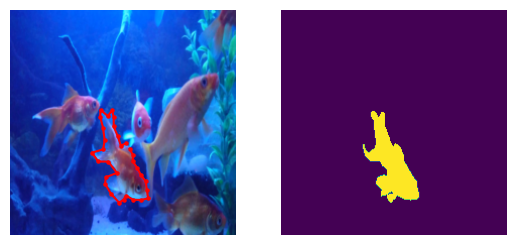

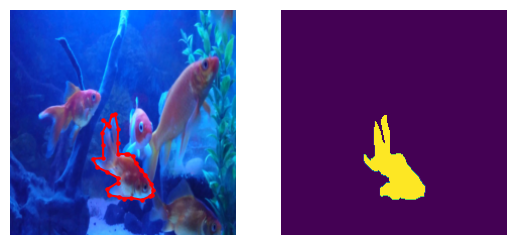

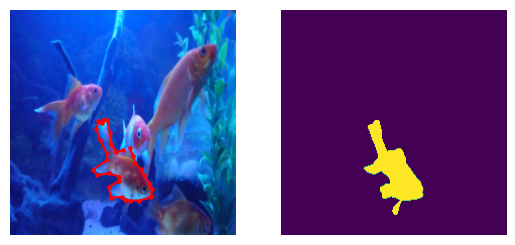

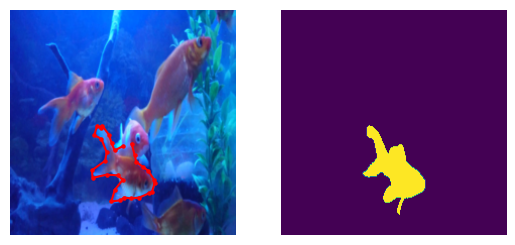

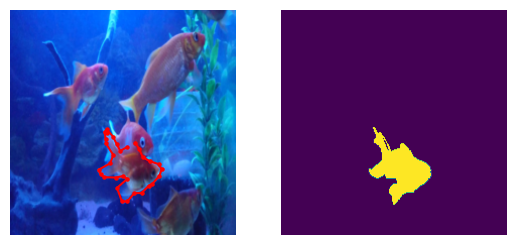

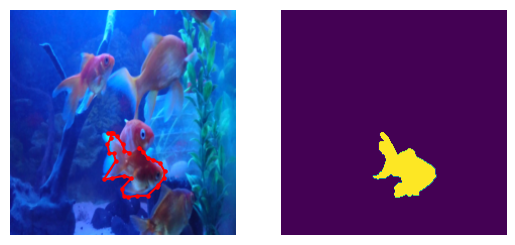

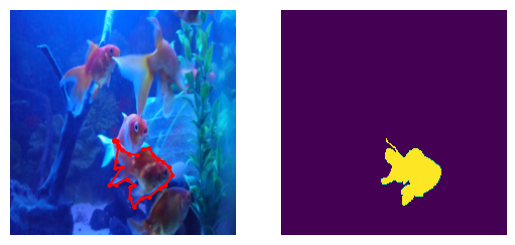

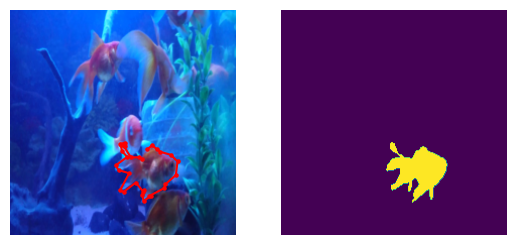

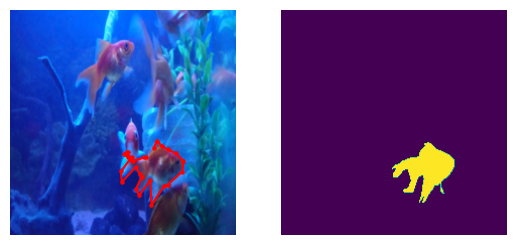

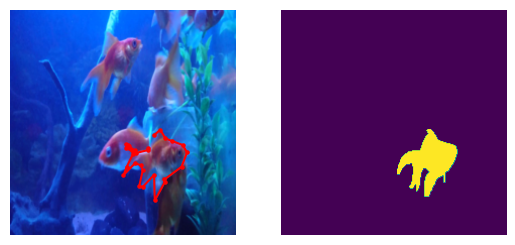

In [19]:
# show the prediction
for i in range(len(total_imgs[0])):
    plt.subplot(1, 2, 1)
    plt.axis("off")
    plt.imshow(normalize(total_imgs[0][i]).permute(1, 2, 0))
    if i == 0:
        plt.plot(total_points[0][i][:, 0], total_points[0][i][:, 1], c="r")
        plt.scatter(total_points[0][i][:, 0], total_points[0][i][:, 1], c="r", s=5)
    else:
        tmp_points = pred_points[0][-1][i - 1]
        plt.plot(tmp_points[:, 0].cpu().detach().numpy(), tmp_points[:, 1].cpu().detach().numpy(), c="r")
        plt.scatter(tmp_points[:, 0].cpu().detach().numpy(), tmp_points[:, 1].cpu().detach().numpy(), c="r", s=5)
    plt.subplot(1, 2, 2)
    plt.axis("off")
    plt.imshow(total_masks[0][i].cpu().detach().numpy())
    plt.show()

In [22]:
class CoEvaler:
    def __init__(
        self,
        raw_set: list[list[tuple[torch.Tensor, torch.Tensor, torch.Tensor]]],
        gt_rasterizer: SoftPolygon,
        frame_num: int = 10,
    ):
        self.raw_set = raw_set
        self.frame_num = frame_num
        self.gt_rasterizer = gt_rasterizer
        self.total_pred_results = []

    def eval_one_video(self, video_idx: int, model: nn.Module):
        video_data = self.raw_set[video_idx]
        total_frame_num = len(video_data)
        img_list = []
        mask_list = []
        point_list = []
        for frame_idx in range(total_frame_num):
            img, mask, point = video_data[frame_idx]
            img_list.append(img)
            mask_list.append(mask)
            point_list.append(point)
        total_masks = torch.stack(mask_list)
        total_points = torch.stack(point_list)
        total_pred_points = torch.zeros_like(total_points)
        total_pred_points[0] = total_points[0]
        interval = (total_frame_num - 1) // (self.frame_num - 1)
        offset_min = -(interval - 1)
        offset_max = (total_frame_num - 1) - (self.frame_num - 1) * interval
        done_idx_list = [0]
        for offset in range(offset_min, offset_max + 1):
            selected_frame_idxs = [0]
            for i in range(1, self.frame_num):
                selected_frame_idxs.append(i * interval + offset)
            selected_frame_idxs = sorted(selected_frame_idxs)
            img_list = []
            mask_list = []
            point_list = []
            fir_point = video_data[0][2]
            for frame_idx in selected_frame_idxs:
                img, mask, point = video_data[frame_idx]
                img_list.append(img)
                mask_list.append(mask)
                point_list.append(fir_point)
            imgs = torch.stack(img_list).unsqueeze(0)
            masks = torch.stack(mask_list).unsqueeze(0)
            points = torch.stack(point_list).unsqueeze(0)
            with torch.no_grad():
                model.eval()
                pred_points = model(imgs.cuda(), points.cuda())
                pred_points = pred_points.clamp(0, 223)
            pred_points = pred_points[0][-1]
            for result_idx, frame_idx in enumerate(selected_frame_idxs[1:]):
                if frame_idx in done_idx_list:
                    continue
                done_idx_list.append(frame_idx)
                total_pred_points[frame_idx] = pred_points[result_idx]
        total_iou = get_batch_average_bou_iou(
            total_pred_points.cuda(),
            total_masks.cuda(),
            self.gt_rasterizer,
        )
        return total_iou, total_pred_points

    def compute_avg_iou(self):
        iou_list = [iou for iou, _ in self.total_pred_results]
        return sum(iou_list) / len(iou_list)

    def eval_all_video(self, model: nn.Module, use_tqdm=False):
        self.total_pred_results = []
        video_num = len(self.raw_set)
        if use_tqdm:
            video_idx_list = tqdm(range(video_num))
        else:
            video_idx_list = range(video_num)
        for video_idx in video_idx_list:
            iou, pred_points = self.eval_one_video(video_idx, model)
            self.total_pred_results.append((iou, pred_points))
        return self.compute_avg_iou()

    def show_iou_distribution(self):
        iou_list = [iou.item() for iou, _ in self.total_pred_results]
        plt.hist(iou_list, bins=20)
        plt.show()

    def show_video_result(
        self,
        video_idx: int,
        gt_rasterizer: SoftPolygon,
        img_per_line=5,
        mask_alpha=0.2,
    ):
        video_data = self.raw_set[video_idx]
        frame_num = len(video_data)
        line_num = (frame_num - 1) // img_per_line + 1
        total_pred_points = self.total_pred_results[video_idx][1]
        plt.figure(figsize=(img_per_line * 4, line_num * 4))
        for i, pred_point in enumerate(total_pred_points):
            plt.subplot(line_num, img_per_line, i + 1)
            plt.axis("off")
            img, mask, point = video_data[i]
            plt.imshow(normalize(img).permute(1, 2, 0))
            iou = get_batch_average_bou_iou(pred_point.unsqueeze(0).cuda(), mask.unsqueeze(0).cuda(), gt_rasterizer).item()
            plt.title(f"IoU: {iou:.4f}")
            plt.scatter(pred_point[:, 0], pred_point[:, 1], c="r", s=5)
            plt.plot(pred_point[:, 0], pred_point[:, 1], c="r")
            plt.imshow(mask, alpha=mask_alpha)


coevaler = CoEvaler(val_point_set.raw_data_set, gt_rasterizer)
coevaler.raw_set = coevaler.raw_set[:2]
iou, pred_points = coevaler.eval_one_video(0, model)
iou, pred_points.shape

(tensor(0.3818, device='cuda:0'), torch.Size([69, 16, 2]))

In [102]:
coevaler.eval_all_video(model, use_tqdm=True)

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:08<00:00,  4.01s/it]


tensor(0.4916, device='cuda:0')

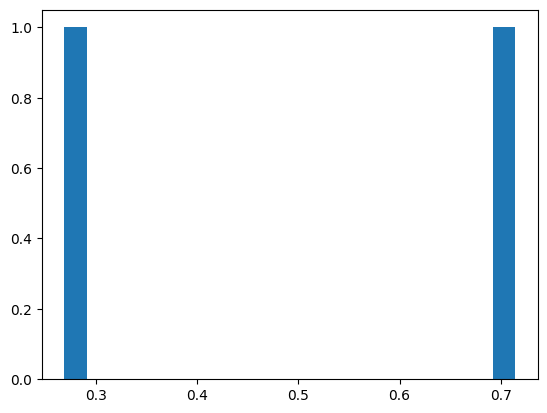

In [103]:
coevaler.show_iou_distribution()

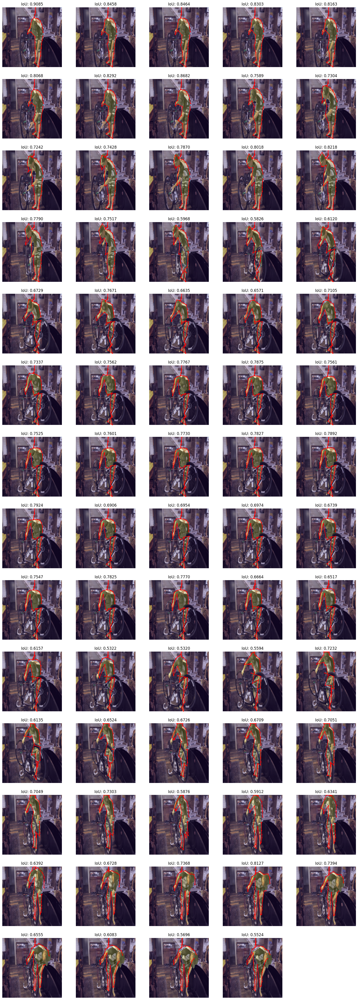

In [104]:
coevaler.show_video_result(0, gt_rasterizer)

In [66]:
model = Cotracker(32).cuda()
optimizer = Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [67]:
video_idx = 22

In [69]:
val_video_set = DAVIS_Video(val_point_set.raw_data_set, 10, [video_idx])
val_video_loader = DataLoader(val_video_set, batch_size=1, shuffle=False)

In [70]:
loss_dict = {}
train_iou_dict = {}
eval_iou_dict = {}
epoch_num = 200
eval_interval = 10

In [71]:
for e in range(epoch_num):
    total_loss = 0
    total_iou = 0
    for total_imgs, total_masks, total_points in val_video_loader:
        optimizer.zero_grad()
        pred_points = model(total_imgs.cuda(), total_points.cuda())
        target_masks = total_masks[:, 1:]
        loss, iou = video_loss(pred_points, target_masks.cuda())
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        total_iou += iou.item()
    loss_dict[e] = total_loss / len(val_video_loader)
    train_iou_dict[e] = total_iou / len(val_video_loader)
    print(f"Epoch {e}, Loss: {loss_dict[e]:.4f}, Train IoU: {train_iou_dict[e]:.4f}")
    if e % eval_interval == 0 or e == epoch_num - 1:
        iou, pred_points = coevaler.eval_one_video(video_idx, model)
        eval_iou_dict[e] = iou
        print(f"Epoch {e}, Eval IoU: {eval_iou_dict[e]:.4f}")

Epoch 0, Loss: 0.5494, Train IoU: 0.3221
Epoch 0, Eval IoU: 0.3730
Epoch 1, Loss: 0.4307, Train IoU: 0.3755
Epoch 2, Loss: 0.4044, Train IoU: 0.4058
Epoch 3, Loss: 0.3809, Train IoU: 0.4628
Epoch 4, Loss: 0.3781, Train IoU: 0.5149
Epoch 5, Loss: 0.4133, Train IoU: 0.5089
Epoch 6, Loss: 0.3222, Train IoU: 0.5565
Epoch 7, Loss: 0.3919, Train IoU: 0.5244
Epoch 8, Loss: 0.3640, Train IoU: 0.5489
Epoch 9, Loss: 0.3240, Train IoU: 0.5593
Epoch 10, Loss: 0.3270, Train IoU: 0.5672
Epoch 10, Eval IoU: 0.5312
Epoch 11, Loss: 0.3173, Train IoU: 0.5652
Epoch 12, Loss: 0.3002, Train IoU: 0.5688
Epoch 13, Loss: 0.3109, Train IoU: 0.5596
Epoch 14, Loss: 0.3123, Train IoU: 0.5697
Epoch 15, Loss: 0.2714, Train IoU: 0.5505
Epoch 16, Loss: 0.2679, Train IoU: 0.6047
Epoch 17, Loss: 0.2420, Train IoU: 0.6175
Epoch 18, Loss: 0.2550, Train IoU: 0.6531
Epoch 19, Loss: 0.2507, Train IoU: 0.6814
Epoch 20, Loss: 0.2433, Train IoU: 0.6543
Epoch 20, Eval IoU: 0.6899
Epoch 21, Loss: 0.2870, Train IoU: 0.6584
Epoch 

In [73]:
iou, total_pred_points = coevaler.eval_one_video(video_idx, model)

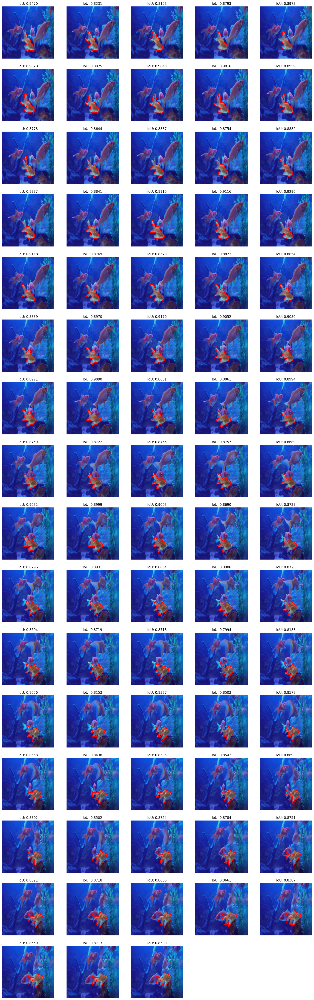

In [79]:
img_per_line = 5
mask_alpha = 0.2
video_data = coevaler.raw_set[video_idx]
frame_num = len(video_data)
line_num = frame_num // img_per_line + 1
plt.figure(figsize=(20, 4 * line_num))
for i, pred_point in enumerate(total_pred_points):
    plt.subplot(line_num, img_per_line, i + 1)
    plt.axis("off")
    img, mask, point = video_data[i]
    plt.imshow(normalize(img).permute(1, 2, 0))
    iou = get_batch_average_bou_iou(pred_point.unsqueeze(0).cuda(), mask.unsqueeze(0).cuda(), gt_rasterizer).item()
    plt.title(f"IoU: {iou:.4f}")
    plt.scatter(pred_point[:, 0], pred_point[:, 1], c="r", s=5)
    plt.plot(pred_point[:, 0], pred_point[:, 1], c="r")
    plt.imshow(mask, alpha=mask_alpha)

In [113]:
model = Cotracker(32).cuda()
optimizer = Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [117]:
val_video_set = DAVIS_Video(val_point_set.raw_data_set, 10)
val_video_loader = DataLoader(val_video_set, batch_size=1, shuffle=False)
coevaler = CoEvaler(val_point_set.raw_data_set, gt_rasterizer)

In [118]:
loss_dict = {}
train_iou_dict = {}
eval_iou_dict = {}
epoch_num = 200
eval_interval = 10

In [119]:
for e in range(epoch_num):
    total_loss = 0
    total_iou = 0
    for total_imgs, total_masks, total_points in tqdm(val_video_loader):
        optimizer.zero_grad()
        pred_points = model(total_imgs.cuda(), total_points.cuda())
        target_masks = total_masks[:, 1:]
        loss, iou = video_loss(pred_points, target_masks.cuda())
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        total_iou += iou.item()
    loss_dict[e] = total_loss / len(val_video_loader)
    train_iou_dict[e] = total_iou / len(val_video_loader)
    print(f"Epoch {e}, Loss: {loss_dict[e]:.4f}, Train IoU: {train_iou_dict[e]:.4f}")
    if e % eval_interval == 0 or e == epoch_num - 1:
        avg_iou = coevaler.eval_all_video(model, use_tqdm=True)
        eval_iou_dict[e] = avg_iou
        print(f"Epoch {e}, Eval IoU: {eval_iou_dict[e]:.4f}")

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 0, Loss: 0.6976, Train IoU: 0.2103


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:41<00:00,  3.88s/it]


Epoch 0, Eval IoU: 0.2564


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 1, Loss: 0.6773, Train IoU: 0.2303


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 2, Loss: 0.6420, Train IoU: 0.2597


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 3, Loss: 0.6195, Train IoU: 0.2675


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 4, Loss: 0.5942, Train IoU: 0.2891


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 5, Loss: 0.5647, Train IoU: 0.3188


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 6, Loss: 0.5375, Train IoU: 0.3520


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 7, Loss: 0.5433, Train IoU: 0.3364


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 8, Loss: 0.5377, Train IoU: 0.3432


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 9, Loss: 0.5170, Train IoU: 0.3572


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 10, Loss: 0.4954, Train IoU: 0.3928


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:41<00:00,  3.88s/it]


Epoch 10, Eval IoU: 0.4193


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 11, Loss: 0.4674, Train IoU: 0.4223


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 12, Loss: 0.4614, Train IoU: 0.4282


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 13, Loss: 0.4535, Train IoU: 0.4376


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 14, Loss: 0.4583, Train IoU: 0.4308


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 15, Loss: 0.4509, Train IoU: 0.4363


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 16, Loss: 0.4523, Train IoU: 0.4349


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 17, Loss: 0.4326, Train IoU: 0.4563


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 18, Loss: 0.4329, Train IoU: 0.4541


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 19, Loss: 0.4274, Train IoU: 0.4616


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 20, Loss: 0.4082, Train IoU: 0.4900


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:40<00:00,  3.87s/it]


Epoch 20, Eval IoU: 0.4916


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 21, Loss: 0.3965, Train IoU: 0.4986


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 22, Loss: 0.4063, Train IoU: 0.4905


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 23, Loss: 0.4018, Train IoU: 0.4915


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 24, Loss: 0.4055, Train IoU: 0.4920


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 25, Loss: 0.4011, Train IoU: 0.5002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 26, Loss: 0.4005, Train IoU: 0.4975


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 27, Loss: 0.3858, Train IoU: 0.5096


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 28, Loss: 0.3752, Train IoU: 0.5289


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 29, Loss: 0.3761, Train IoU: 0.5237


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 30, Loss: 0.3675, Train IoU: 0.5313


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:40<00:00,  3.87s/it]


Epoch 30, Eval IoU: 0.5112


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 31, Loss: 0.3858, Train IoU: 0.5134


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 32, Loss: 0.3800, Train IoU: 0.5160


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 33, Loss: 0.3842, Train IoU: 0.5116


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 34, Loss: 0.3859, Train IoU: 0.5094


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 35, Loss: 0.3741, Train IoU: 0.5250


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 36, Loss: 0.3659, Train IoU: 0.5373


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 37, Loss: 0.3557, Train IoU: 0.5507


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 38, Loss: 0.3428, Train IoU: 0.5583


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 39, Loss: 0.3565, Train IoU: 0.5434


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 40, Loss: 0.3637, Train IoU: 0.5328


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:41<00:00,  3.88s/it]


Epoch 40, Eval IoU: 0.5520


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 41, Loss: 0.3460, Train IoU: 0.5552


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 42, Loss: 0.3441, Train IoU: 0.5624


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 43, Loss: 0.3475, Train IoU: 0.5552


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 44, Loss: 0.3493, Train IoU: 0.5499


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 45, Loss: 0.3622, Train IoU: 0.5346


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 46, Loss: 0.3534, Train IoU: 0.5473


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 47, Loss: 0.3417, Train IoU: 0.5687


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 48, Loss: 0.3322, Train IoU: 0.5763


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 49, Loss: 0.3421, Train IoU: 0.5589


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 50, Loss: 0.3444, Train IoU: 0.5635


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:41<00:00,  3.88s/it]


Epoch 50, Eval IoU: 0.5683


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 51, Loss: 0.3415, Train IoU: 0.5651


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 52, Loss: 0.3434, Train IoU: 0.5565


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 53, Loss: 0.3465, Train IoU: 0.5545


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 54, Loss: 0.3400, Train IoU: 0.5669


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 55, Loss: 0.3234, Train IoU: 0.5891


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 56, Loss: 0.3170, Train IoU: 0.5934


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 57, Loss: 0.3235, Train IoU: 0.5892


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 58, Loss: 0.3273, Train IoU: 0.5812


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 59, Loss: 0.3413, Train IoU: 0.5581


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 60, Loss: 0.3390, Train IoU: 0.5638


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:41<00:00,  3.88s/it]


Epoch 60, Eval IoU: 0.5635


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 61, Loss: 0.3234, Train IoU: 0.5890


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 62, Loss: 0.3235, Train IoU: 0.5840


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 63, Loss: 0.3314, Train IoU: 0.5698


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 64, Loss: 0.3259, Train IoU: 0.5800


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 65, Loss: 0.3231, Train IoU: 0.5866


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 66, Loss: 0.3209, Train IoU: 0.5883


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 67, Loss: 0.3118, Train IoU: 0.6037


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 68, Loss: 0.3069, Train IoU: 0.6048


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 69, Loss: 0.3142, Train IoU: 0.5971


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 70, Loss: 0.3137, Train IoU: 0.5972


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:41<00:00,  3.89s/it]


Epoch 70, Eval IoU: 0.6028


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 71, Loss: 0.3053, Train IoU: 0.6073


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 72, Loss: 0.3114, Train IoU: 0.5951


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 73, Loss: 0.3075, Train IoU: 0.6049


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 74, Loss: 0.3128, Train IoU: 0.5955


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 75, Loss: 0.3189, Train IoU: 0.5881


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 76, Loss: 0.3167, Train IoU: 0.5939


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 77, Loss: 0.3182, Train IoU: 0.5959


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 78, Loss: 0.3078, Train IoU: 0.6058


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 79, Loss: 0.3039, Train IoU: 0.6099


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 80, Loss: 0.3117, Train IoU: 0.5994


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:41<00:00,  3.89s/it]


Epoch 80, Eval IoU: 0.6045


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 81, Loss: 0.3055, Train IoU: 0.6061


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 82, Loss: 0.3059, Train IoU: 0.6066


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.98it/s]


Epoch 83, Loss: 0.3102, Train IoU: 0.6044


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 84, Loss: 0.3007, Train IoU: 0.6124


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 85, Loss: 0.2989, Train IoU: 0.6189


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 86, Loss: 0.3068, Train IoU: 0.6034


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 87, Loss: 0.3091, Train IoU: 0.6042


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 88, Loss: 0.3093, Train IoU: 0.6075


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 89, Loss: 0.3114, Train IoU: 0.6013


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 90, Loss: 0.3008, Train IoU: 0.6118


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:42<00:00,  3.90s/it]


Epoch 90, Eval IoU: 0.5960


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 91, Loss: 0.3030, Train IoU: 0.6128


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.98it/s]


Epoch 92, Loss: 0.2976, Train IoU: 0.6168


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.98it/s]


Epoch 93, Loss: 0.2984, Train IoU: 0.6165


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.98it/s]


Epoch 94, Loss: 0.3012, Train IoU: 0.6150


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 95, Loss: 0.2956, Train IoU: 0.6226


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.98it/s]


Epoch 96, Loss: 0.2911, Train IoU: 0.6226


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.97it/s]


Epoch 97, Loss: 0.2944, Train IoU: 0.6240


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.97it/s]


Epoch 98, Loss: 0.2922, Train IoU: 0.6256


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.98it/s]


Epoch 99, Loss: 0.2990, Train IoU: 0.6205


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 100, Loss: 0.3048, Train IoU: 0.6119


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:41<00:00,  3.89s/it]


Epoch 100, Eval IoU: 0.6169


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  1.99it/s]


Epoch 101, Loss: 0.2975, Train IoU: 0.6177


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 102, Loss: 0.2895, Train IoU: 0.6332


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:28<00:00,  2.00it/s]


Epoch 103, Loss: 0.2871, Train IoU: 0.6342


 28%|███████████████████████████████████████▊                                                                                                      | 16/57 [00:08<00:21,  1.90it/s]


KeyboardInterrupt: 

In [9]:
model = Cotracker(32).cuda()
optimizer = Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [12]:
val_video_set = DAVIS_Video(val_point_set.raw_data_set, 10)
coevaler = CoEvaler(val_point_set.raw_data_set, gt_rasterizer)
train_video_set = DAVIS_Video(train_point_set.raw_data_set, 10)
train_video_loader = DataLoader(train_video_set, batch_size=1, shuffle=True)

In [14]:
loss_dict = {}
train_iou_dict = {}
eval_iou_dict = {}
epoch_num = 4
eval_interval = 2

In [17]:
for e in range(epoch_num):
    total_loss = 0
    total_iou = 0
    for total_imgs, total_masks, total_points in tqdm(train_video_loader):
        optimizer.zero_grad()
        pred_points = model(total_imgs.cuda(), total_points.cuda())
        target_masks = total_masks[:, 1:]
        loss, iou = video_loss(pred_points, target_masks.cuda())
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        total_iou += iou.item()
    loss_dict[e] = total_loss / len(train_video_loader)
    train_iou_dict[e] = total_iou / len(train_video_loader)
    print(f"Epoch {e}, Loss: {loss_dict[e]:.4f}, Train IoU: {train_iou_dict[e]:.4f}")
    if e % eval_interval == 0 or e == epoch_num - 1:
        avg_iou = coevaler.eval_all_video(model, use_tqdm=True)
        eval_iou_dict[e] = avg_iou
        print(f"Epoch {e}, Eval IoU: {eval_iou_dict[e]:.4f}")

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 111/111 [02:10<00:00,  1.17s/it]


Epoch 0, Loss: 0.7230, Train IoU: 0.1839


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [06:07<00:00,  6.45s/it]


Epoch 0, Eval IoU: 0.2357


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 111/111 [01:28<00:00,  1.26it/s]


Epoch 1, Loss: 0.7046, Train IoU: 0.2031


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 111/111 [02:22<00:00,  1.28s/it]


Epoch 2, Loss: 0.6869, Train IoU: 0.2221


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [05:18<00:00,  5.58s/it]


Epoch 2, Eval IoU: 0.2491


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 111/111 [01:12<00:00,  1.53it/s]


Epoch 3, Loss: 0.6683, Train IoU: 0.2311


  9%|████████████▌                                                                                                                                  | 5/57 [00:30<05:21,  6.18s/it]


KeyboardInterrupt: 

In [7]:
class CotrackerLight(nn.Module):
    def __init__(
        self,
        point_num: int,
        refine_iter: int = 1,
        freeze_featup: bool = True,
        d_model: int = 128,
        n_heads: int = 8,
        n_points: int = 4,
        d_ffn: int = 512,
        n_layers: int = 1,
        offset_ratio: float = 1.0,
    ):
        super(CotrackerLight, self).__init__()
        self.refine_iter = refine_iter
        self.featup = torch.hub.load(
            "mhamilton723/FeatUp",
            "dino16",
            use_norm=True,
        )
        if freeze_featup:
            for param in self.featup.parameters():
                param.requires_grad = False
        d_featup = 384
        if d_featup != d_model:
            self.featup_fc = nn.Linear(d_featup, d_model)
        else:
            self.featup_fc = nn.Identity()
        self.medium_level_size = [14, 28, 56, 112]
        n_levels = len(self.medium_level_size) + 1
        self.offset_ratio = offset_ratio
        self.pos_2d = IMGPositionEmbeddingSine(d_model)
        self.pos_1d = PositionalEncoding(d_model)
        self.level_pos = nn.Embedding(n_levels, d_model)
        nn.init.xavier_uniform_(self.level_pos.weight)

        self.query_embed = nn.Embedding(point_num, d_model)
        nn.init.xavier_uniform_(self.query_embed.weight)
        dec_layer = DeformableTransformerDecoderLayer(
            d_model=d_model,
            d_ffn=d_ffn,
            n_levels=n_levels,
            n_heads=n_heads,
            n_points=n_points,
        )
        self.def_dec_layernorm = nn.LayerNorm(d_model)
        self.def_decoder = DeformableTransformerDecoder(
            decoder_layer=dec_layer,
            num_layers=n_layers,
        )
        self.fir_layernorm = nn.LayerNorm(d_model)
        self.fir_encoder = nn.TransformerEncoder(
            encoder_layer=nn.TransformerEncoderLayer(
                d_model,
                n_heads,
                d_ffn,
                batch_first=True,
            ),
            num_layers=n_layers,
        )
        self.other_layernorm = nn.LayerNorm(d_model)
        self.other_decoder = nn.TransformerDecoder(
            decoder_layer=nn.TransformerDecoderLayer(
                d_model,
                n_heads,
                d_ffn,
                batch_first=True,
            ),
            num_layers=n_layers,
        )
        self.delta_xy_fc = MLP(d_model, d_model, 2, 2)

    def forward(self, imgs: torch.Tensor, points: torch.Tensor):
        batch_size, frame_num, _, img_h, img_w = imgs.shape
        _, _, point_num, _ = points.shape

        points = points / 224.0

        fir_img = imgs[:, 0]
        fir_points = points[:, 0]
        (
            fir_src_flatten,
            fir_spatial_shapes,
            fir_level_start_index,
            fir_valid_ratios,
            fir_pos_embed_flatten,
        ) = self._get_img_scrs(fir_img, self.def_dec_layernorm)
        fir_src_flatten += fir_pos_embed_flatten
        fir_query_embed = repeat(self.query_embed.weight, "p d -> b p d", b=batch_size)
        fir_point_feats, _ = self.def_decoder(
            fir_query_embed,
            fir_points,
            fir_src_flatten,
            fir_spatial_shapes,
            fir_level_start_index,
            fir_valid_ratios,
        )
        fir_point_feats = self.fir_layernorm(fir_point_feats)
        fir_query = self.pos_1d(fir_point_feats)
        fir_memory = self.fir_encoder(fir_query)

        other_imgs = imgs[:, 1:]
        other_points = points[:, 1:]
        other_imgs = rearrange(other_imgs, "b f c h w -> (b f) c h w")
        other_points = rearrange(other_points, "b f p d -> (b f) p d")
        (
            other_src_flatten,
            other_spatial_shapes,
            other_level_start_index,
            other_valid_ratios,
            other_pos_embed_flatten,
        ) = self._get_img_scrs(other_imgs, self.def_dec_layernorm)
        other_src_flatten += other_pos_embed_flatten
        other_queries = repeat(
            self.query_embed.weight, "p d -> b p d", b=batch_size * (frame_num - 1)
        )

        output_coords = []
        other_point_feats, _ = self.def_decoder(
            other_queries,
            other_points,
            other_src_flatten,
            other_spatial_shapes,
            other_level_start_index,
            other_valid_ratios,
        )
        other_point_queries = rearrange(
            other_point_feats, "(b f)p d -> b (f p) d", f=frame_num - 1
        )
        other_point_queries = self.other_layernorm(other_point_queries)
        other_point_queries = self.pos_1d(other_point_queries)
        other_point_queries = self.other_decoder(
            tgt=other_point_queries,
            memory=fir_memory,
        )
        other_point_queries = rearrange(
            other_point_queries, "b (f p) d -> (b f) p d", f=frame_num - 1
        )
        delta_xy = self.delta_xy_fc(other_point_queries)
        delta_xy = (delta_xy.sigmoid() - 0.5) * self.offset_ratio
        other_points = other_points + delta_xy
        result = rearrange(
            other_points, "(b f) p d -> b f p d", b=batch_size, f=frame_num - 1
        )
        result = result * 224.0
        output_coords.append(result)
        output_coords = torch.stack(output_coords, 1)
        return output_coords

    def _get_img_scrs(self, img: torch.Tensor, layernorm: nn.LayerNorm):
        b, c, h, w = img.shape
        feats = self.featup(img)
        feats = rearrange(feats, "b c h w -> b (h w) c")
        feats = self.featup_fc(feats)
        feats = rearrange(feats, "b (h w) c -> b c h w", h=h, w=w)
        srcs = []
        padding_masks = []
        pos_embeds = []
        for low_res in self.medium_level_size:
            srcs.append(
                F.interpolate(
                    feats,
                    size=(low_res, low_res),
                    mode="bilinear",
                ),
            )
        srcs.append(feats)
        for src in srcs:
            padding_masks.append(torch.zeros_like(src[:, 0:1, :, :]).squeeze(1).bool())
            pos_embeds.append(self.pos_2d(src, padding_masks[-1]))
        src_flatten = []
        spatial_shapes = []
        pos_embed_flatten = []

        for lvl, (src, pos) in enumerate(zip(srcs, pos_embeds)):
            src_flatten.append(
                rearrange(src, "b c h w -> b (h w) c"),
            )
            spatial_shapes.append(src.shape[-2:])
            pos = rearrange(pos, "b c h w -> b (h w) c")
            pos = self.level_pos.weight[lvl].view(1, 1, -1) + pos
            pos_embed_flatten.append(pos)

        level_start_index = torch.cat(
            (
                torch.tensor([0]),
                torch.cumsum(
                    torch.tensor([x.shape[1] for x in src_flatten]),
                    0,
                )[:-1],
            )
        ).cuda()
        src_flatten = torch.cat(src_flatten, 1).cuda()
        pos_embed_flatten = torch.cat(pos_embed_flatten, 1).cuda()
        valid_ratios = torch.stack(
            [get_valid_ratio(mask) for mask in padding_masks],
            1,
        ).cuda()
        spatial_shapes = torch.as_tensor(
            spatial_shapes,
            dtype=torch.long,
            device=src_flatten.device,
        )
        src_flatten = layernorm(src_flatten)

        return (
            src_flatten,
            spatial_shapes,
            level_start_index,
            valid_ratios,
            pos_embed_flatten,
        )

In [6]:
frame_num = 6
point_num = 16

In [8]:
val_point_set = DAVIS_withPoint(val_raw_set, point_num, is_train=False)

tensor(0.8029, device='cuda:0')


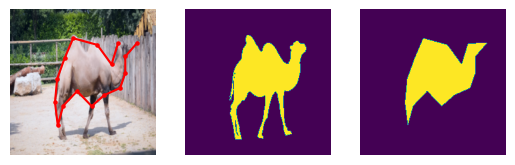

In [9]:
video_idx = 6
frame_idx = 0
img, mask, point = val_point_set.raw_data_set[video_idx][frame_idx]
poly_mask = gt_rasterizer(point.unsqueeze(0).cuda(), 224, 224)
plt.subplot(1, 3, 1)
plt.axis("off")
plt.imshow(normalize(img).permute(1, 2, 0))
plt.plot(point[:, 0], point[:, 1], c="r")
plt.scatter(point[:, 0], point[:, 1], c="r", s=5)
plt.subplot(1, 3, 2)
plt.axis("off")
plt.imshow(mask)
plt.subplot(1, 3, 3)
plt.axis("off")
plt.imshow(poly_mask[0].cpu().detach().numpy())
print(
    get_batch_average_bou_iou(
        point.unsqueeze(0).cuda(),
        mask.unsqueeze(0).cuda(),
        gt_rasterizer,
    )
)

In [10]:
val_video_set = DAVIS_Video(val_point_set.raw_data_set, frame_num, [22], is_eval=True, use_fir_point=False)

In [11]:
val_video_loader = DataLoader(val_video_set, batch_size=1, shuffle=False)

In [12]:
total_imgs, total_masks, total_points = next(iter(val_video_loader))
total_imgs.shape, total_masks.shape, total_points.shape

(torch.Size([1, 6, 3, 224, 224]),
 torch.Size([1, 6, 224, 224]),
 torch.Size([1, 6, 16, 2]))

In [13]:
model = CotrackerLight(point_num).cuda()

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [14]:
with torch.no_grad():
    pred_points = model(total_imgs.cuda(), total_points.cuda())
pred_points.shape

/work3/s232248/miniconda3/envs/rd/lib/python3.11/site-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


torch.Size([1, 1, 5, 16, 2])

In [15]:
optimizer = Adam(model.parameters(), lr=1e-4)

In [16]:
video_idx = 6
val_video_set = DAVIS_Video(val_point_set.raw_data_set, frame_num, [video_idx], is_eval=False, use_fir_point=True)
val_video_loader = DataLoader(val_video_set, batch_size=1, shuffle=False)

In [17]:
loss_dict = {}
iou_dict = {}
epoch_num = 200

In [20]:
for e in range(epoch_num):
    total_loss = 0
    total_iou = 0
    for total_imgs, total_masks, total_points in val_video_loader:
        optimizer.zero_grad()
        pred_points = model(total_imgs.cuda(), total_points.cuda())
        target_masks = total_masks[:, 1:]
        loss, iou = video_loss(pred_points, target_masks.cuda())
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        total_iou += iou.item()
    loss_dict[e] = total_loss / len(val_video_loader)
    iou_dict[e] = total_iou / len(val_video_loader)
    print(f"Epoch {e}, Loss: {loss_dict[e]:.4f}, IoU: {iou_dict[e]:.4f}")

Epoch 0, Loss: 0.4288, IoU: 0.3953
Epoch 1, Loss: 0.4053, IoU: 0.4232
Epoch 2, Loss: 0.3333, IoU: 0.4967
Epoch 3, Loss: 0.3777, IoU: 0.4519
Epoch 4, Loss: 0.3495, IoU: 0.4826
Epoch 5, Loss: 0.3030, IoU: 0.5296
Epoch 6, Loss: 0.3184, IoU: 0.5121
Epoch 7, Loss: 0.2970, IoU: 0.5385
Epoch 8, Loss: 0.2827, IoU: 0.5516
Epoch 9, Loss: 0.2922, IoU: 0.5402
Epoch 10, Loss: 0.3151, IoU: 0.5172
Epoch 11, Loss: 0.2837, IoU: 0.5514
Epoch 12, Loss: 0.2716, IoU: 0.5660
Epoch 13, Loss: 0.2527, IoU: 0.5879
Epoch 14, Loss: 0.2623, IoU: 0.5765
Epoch 15, Loss: 0.2747, IoU: 0.5594
Epoch 16, Loss: 0.2826, IoU: 0.5490
Epoch 17, Loss: 0.2625, IoU: 0.5763
Epoch 18, Loss: 0.2465, IoU: 0.6005
Epoch 19, Loss: 0.2540, IoU: 0.5856
Epoch 20, Loss: 0.2506, IoU: 0.5879
Epoch 21, Loss: 0.2298, IoU: 0.6203
Epoch 22, Loss: 0.2471, IoU: 0.6039
Epoch 23, Loss: 0.2459, IoU: 0.5953
Epoch 24, Loss: 0.2654, IoU: 0.5721
Epoch 25, Loss: 0.2687, IoU: 0.5660
Epoch 26, Loss: 0.2219, IoU: 0.6320
Epoch 27, Loss: 0.2113, IoU: 0.6441
Ep

In [23]:
coevaler = CoEvaler(val_point_set.raw_data_set, gt_rasterizer, frame_num=frame_num)

In [24]:
iou, total_pred_points = coevaler.eval_one_video(video_idx, model)
iou

tensor(0.7268, device='cuda:0')

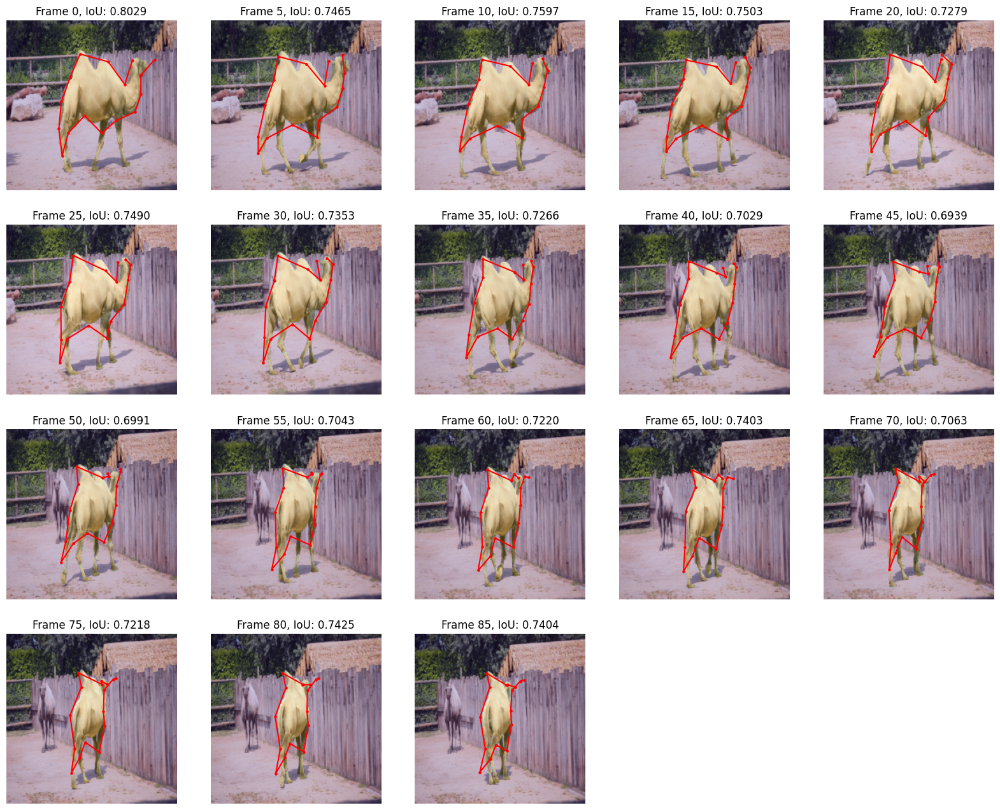

In [25]:
img_per_line = 5
mask_alpha = 0.2
only_show_every = 5
video_data = coevaler.raw_set[video_idx]
frame_num = len(video_data) // only_show_every
line_num = frame_num // img_per_line + 1
plt.figure(figsize=(20, 4 * line_num))
# for i, pred_point in enumerate(total_pred_points):
#     plt.subplot(line_num, img_per_line, i + 1)
#     plt.axis("off")
#     i = i * only_show_every
#     img, mask, point = video_data[i]
#     plt.imshow(normalize(img).permute(1, 2, 0))
#     iou = get_batch_average_bou_iou(pred_point.unsqueeze(0).cuda(), mask.unsqueeze(0).cuda(), gt_rasterizer).item()
#     plt.title(f"IoU: {iou:.4f}")
#     plt.scatter(pred_point[:, 0], pred_point[:, 1], c="r", s=5)
#     plt.plot(pred_point[:, 0], pred_point[:, 1], c="r")
#     plt.imshow(mask, alpha=mask_alpha)

for i in range(frame_num):
    plt.subplot(line_num, img_per_line, i + 1)
    plt.axis("off")
    i = i * only_show_every
    img, mask, point = video_data[i]
    pred_point = total_pred_points[i]
    plt.imshow(normalize(img).permute(1, 2, 0))
    iou = get_batch_average_bou_iou(pred_point.unsqueeze(0).cuda(), mask.unsqueeze(0).cuda(), gt_rasterizer).item()
    plt.title(f"Frame {i}, IoU: {iou:.4f}")
    plt.scatter(pred_point[:, 0], pred_point[:, 1], c="r", s=5)
    plt.plot(pred_point[:, 0], pred_point[:, 1], c="r")
    plt.imshow(mask, alpha=mask_alpha)


    

In [187]:
gc.collect()
torch.cuda.empty_cache()